# Chat-GPT

In [50]:
import os
from openai import OpenAI
from dotenv import load_dotenv

load_dotenv()

gpt_client = OpenAI(
    api_key=os.environ.get('L_CHATGPT_KEY')
)

In [51]:
response = gpt_client.chat.completions.create(
  model="gpt-3.5-turbo",
  messages=[
    {"role": "user", "content": "Who are you?"}
  ]
)

print(response)

ChatCompletion(id='chatcmpl-9LDUTU1ZD10mEI93hs996aGWWAaY5', choices=[Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='I am an AI digital assistant designed to assist with answering questions and providing information to the best of my abilities. How can I help you today?', role='assistant', function_call=None, tool_calls=None))], created=1714843773, model='gpt-3.5-turbo-0125', object='chat.completion', system_fingerprint='fp_a450710239', usage=CompletionUsage(completion_tokens=29, prompt_tokens=11, total_tokens=40))


In [52]:
print(response.choices[0].message.role)
print(response.choices[0].message.content)

assistant
I am an AI digital assistant designed to assist with answering questions and providing information to the best of my abilities. How can I help you today?


# Telegram

In [25]:
import os
from datetime import datetime
from json import dump
from os import getcwd, makedirs, path
from dotenv import load_dotenv

from modules.functions import (
    calculate_coordinates,
    calculate_length,
    generate_pattern,
    load_existing_data,
)

from modules.banners import (
    banner,
    finishing_application,
    pring_city_by_geo,
    print_combined_data,
    print_current_step,
    print_files_stored,
    print_geo_coordinater,
    print_len_steps,
    print_start_harvesting,
    print_successfully,
    print_telegram_initialization,
    print_update_html,
    print_update_local_json,
)

from telethon import TelegramClient
from telethon import functions, types
import asyncio

import asyncio
from ipywidgets import widgets, interact
from IPython.display import display

load_dotenv()

APP_NAME = os.getenv('APP_NAME')
API_ID = int(os.getenv('APP_ID'))
API_HASH = os.getenv('API_HASH')

In [26]:
async def harvest_locations(client, step_coordinates, users_data, avatar_directory, report_json_directory, filename, step):

    # Iterate over latitude and longitude pairs in step_coordinates
    for latitude, longitude in step_coordinates:
        result = await client(functions.contacts.GetLocatedRequest(
            geo_point=types.InputGeoPoint(
                lat=latitude,
                long=longitude,
                accuracy_radius=500
            )
        ))

        # Print the step and its coordinates
        print_start_harvesting()
        step += 1

        # Print current step with coordinates
        print_current_step(step, latitude, longitude)

        for update in result.updates:
            if isinstance(update, types.UpdatePeerLocated):
                for peer_located in update.peers:
                    if peer_located.distance == 500:
                        if isinstance(peer_located.peer, types.PeerUser):  # Check if the peer is a PeerUser
                            user_id = peer_located.peer.user_id
                            user_info = next((user for user in result.users if user.id == user_id), None)
                            if user_info:
                                # Get current timestamp
                                timestamp = datetime.now().strftime("%Y-%m-%d %H:%M:%S")

                                if user_id not in users_data:
                                    # If the user is not in the dictionary, add them with initial data
                                    username = user_info.username
                                    if user_info.photo:
                                        photo_id = user_info.photo.photo_id
                                    else:
                                        photo_id = None
                                    users_data[user_id] = {
                                        "first_name": user_info.first_name,
                                        "last_name": user_info.last_name,
                                        "username": user_info.username,
                                        "phone": user_info.phone,
                                        "photo_id": photo_id,
                                        "coordinates": [],
                                        "coordinates_average": {"latitude": 0, "longitude": 0, "timestamp": 0}
                                    }
                                    # Download avatar
                                    if username:
                                        avatar_filename = path.join(avatar_directory, f"{username}.jpg")
                                        if avatar_filename:
                                            if not path.exists(avatar_filename):
                                                try:
                                                    await client.download_profile_photo(username, file=avatar_directory + username, download_big=True)
                                                    print(f"Foto de perfil descargada exitosamente en {avatar_directory + username}")
                                                except Exception as e:
                                                    print(f"Error downloading profile photo for {username}: {e}")
                                    else:
                                        if photo_id:
                                            avatar_filename = path.join(avatar_directory, f"{photo_id}.jpg")
                                            if avatar_filename:
                                                if not path.exists(avatar_filename):
                                                    try:
                                                        await client.download_media(photo_id, f"{avatar_directory + str(photo_id)}.jpg")
                                                        print(f"Foto de perfil descargada exitosamente en {avatar_directory + str(photo_id)}")
                                                    except Exception as e:
                                                        print(f"Error downloading profile photo for {photo_id}: {e}")

                                # Append new coordinates
                                users_data[user_id]["coordinates"].append((latitude, longitude, timestamp))

                                # Calculate average coordinates
                                avg_latitude = sum(coord[0] for coord in users_data[user_id]["coordinates"]) / len(users_data[user_id]["coordinates"])
                                avg_longitude = sum(coord[1] for coord in users_data[user_id]["coordinates"]) / len(users_data[user_id]["coordinates"])

                                # Update the average coordinates
                                users_data[user_id]["coordinates_average"] = {"latitude": avg_latitude, "longitude": avg_longitude}


        # Write the updated data to the file
        print_update_local_json()
        with open(report_json_directory + filename + ".json", 'w') as file:
            dump(users_data, file, indent=4)
        print_successfully()

In [30]:
async def main(latitude, longitude):
    from modules.general_settings import meters

    pattern = generate_pattern((calculate_length(meters + 400) + 800) // 200)
    current_datetime = datetime.now().strftime('%Y-%m-%d_%H-%M-%S')

    step_coordinates = []

    step = 0
    users_data = {}
    filename = f'{latitude}-{longitude}-{current_datetime}'

    avatar_directory = "./avatars/"
    report_json_directory = "./reports-json/"

    if not path.exists(avatar_directory):
        makedirs(avatar_directory)
    if not path.exists(report_json_directory):
        makedirs(report_json_directory)

    print_geo_coordinater(latitude,longitude)

    pring_city_by_geo(latitude,longitude)

    # Perform steps according to the pattern
    for i, steps in enumerate(pattern):
        if i == 0:
            direction = 'starting'
        elif i % 4 == 1:
            direction = 'west'
        elif i % 4 == 2:
            direction = 'south'
        elif i % 4 == 3:
            direction = 'east'
        else:
            direction = 'north'
        for _ in range(steps):
            latitude, longitude = calculate_coordinates(latitude, longitude, direction, 0.6)  # 600 meters in kilometers
            step_coordinates.append((latitude, longitude))

    # Load existing data from file
    users_data = load_existing_data(report_json_directory + filename)

    ### Print number of steps
    print_len_steps(len(step_coordinates), meters)

    # Initialize the Telegram client
    print_telegram_initialization()

    # Inicializa el cliente de Telegram
    client = TelegramClient(APP_NAME, API_ID, API_HASH)
    await client.start()
    print_successfully()

    await harvest_locations(client, step_coordinates, users_data, avatar_directory, report_json_directory, filename, step)

    await client.disconnect()

In [32]:
# Función modificada para ejecutar código asincrónico en Jupyter
def run_main():
    latitude_text = widgets.FloatText(
        value=39.4779,
        description='Latitud:',
        disabled=False
    )
    longitude_text = widgets.FloatText(
        value=-0.3330,
        description='Longitud:',
        disabled=False
    )
    
    button_run = widgets.Button(description="Ejecutar")

    output = widgets.Output()

    display(latitude_text, longitude_text, button_run, output)
    
    def on_button_clicked(b):
        with output:
            output.clear_output()
            print("Ejecutando con latitud:", latitude_text.value, "y longitud:", longitude_text.value)
            # Cambio aquí: en lugar de usar asyncio.run(), utiliza el loop existente
            asyncio.create_task(main(latitude_text.value, longitude_text.value))
    
    button_run.on_click(on_button_clicked)

run_main()

FloatText(value=39.4779, description='Latitud:')

FloatText(value=-0.333, description='Longitud:')

Button(description='Ejecutar', style=ButtonStyle())

Output()

[ * ] Harvesting information based on the next coordinates:
	[ * * ] Latitude:  39.4779
	[ * * ] Longitude: -0.333
	[ * * ] Country:   España
	[ * * ] City:	   València
	[ * * ] Town:	   

[ * ] Overall steps to be performed: 25 , with overall diameter 2400 meters

[ * ] Telegram client initialization...successfully

[ * ] Start harvesting data:
	[ 1 ] Latitude 39.4779, Longitude -0.333
Foto de perfil descargada exitosamente en ./avatars/6014992855443028984
Foto de perfil descargada exitosamente en ./avatars/5778303280844226052
Foto de perfil descargada exitosamente en ./avatars/5850339971276325063
Foto de perfil descargada exitosamente en ./avatars/Albertowateke
Foto de perfil descargada exitosamente en ./avatars/5908834346356293499
Foto de perfil descargada exitosamente en ./avatars/5893289163199986549
Foto de perfil descargada exitosamente en ./avatars/6028521061827590970
Foto de perfil descargada exitosamente en ./avatars/5832570364427877921
Foto de perfil descargada exitosamente e

In [33]:
import json

import folium
from folium.features import CustomIcon
from folium import Map, Marker, Tooltip
from folium.plugins import MarkerCluster

with open('reports-json/users_data.json', 'r') as f:
    data = json.load(f)


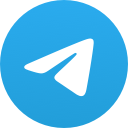
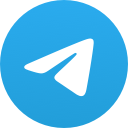
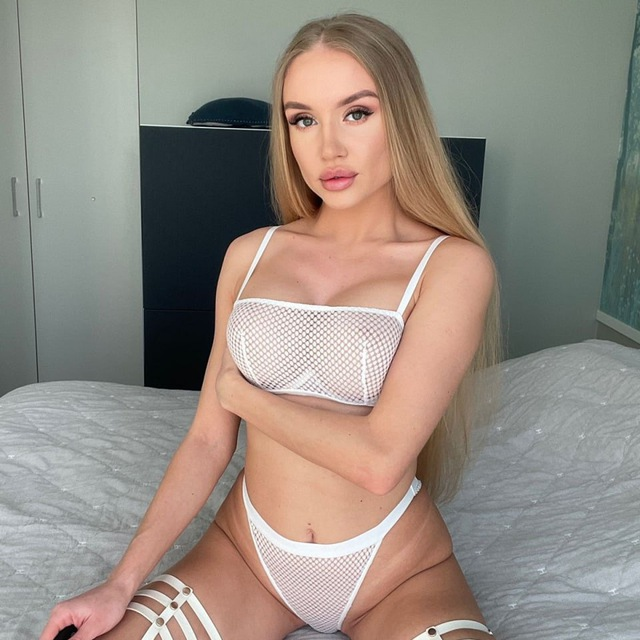
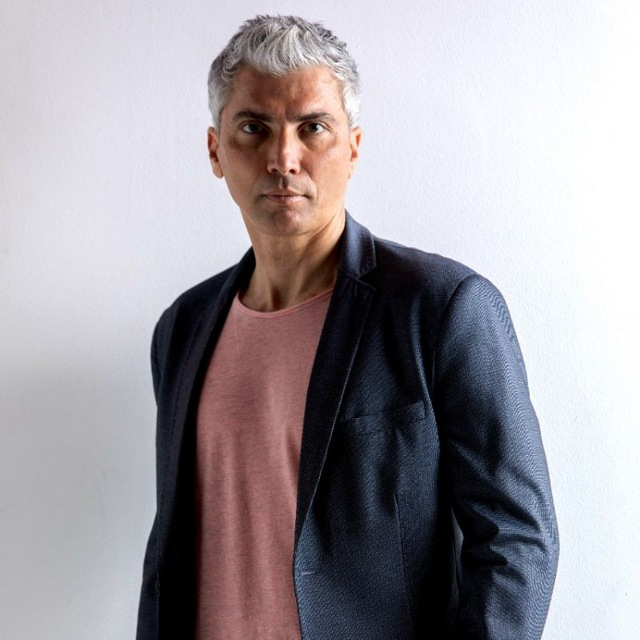
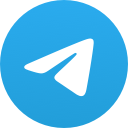
...
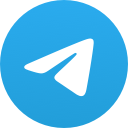
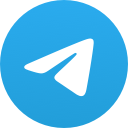
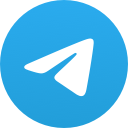
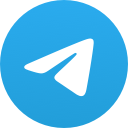
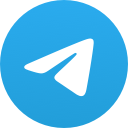

In [34]:
# Crea un mapa base. Ajusta la ubicación inicial y el nivel de zoom según sea necesario.
mapa = folium.Map(location=[39.477988, -0.332996], zoom_start=12)

marker_cluster = MarkerCluster().add_to(mapa)

# Itera sobre cada usuario en tu JSON
for user_id, user_info in data.items():
    # Extrae la latitud y longitud promedio
    lat = user_info['coordinates_average']['latitude']
    lon = user_info['coordinates_average']['longitude']
    
    username = user_info['username']

    if username:
        path_image = f'avatars/{username}.jpg'
    else:
        path_image = 'avatars/no_avatar.jpg'

    # Comprueba si el archivo existe
    if not os.path.isfile(path_image):
        # Si no existe, usa el archivo por defecto
        path_image = 'avatars/no_avatar.jpg'

    icon = CustomIcon(
        path_image,  # Ruta a la imagen de perfil del usuario
        icon_size=(25, 25)  # Puedes ajustar el tamaño según necesites
    )
    
    phone_text = "Sin teléfono" if user_info["phone"] is None else user_info["phone"]

    # Opcionalmente, crea una etiqueta con información del usuario
    tooltip = Tooltip(f'{user_info["first_name"]}, {phone_text}')

    # Añade un marcador al mapa para este usuario
    Marker(
        [lat, lon],
        icon=icon, 
        tooltip=tooltip
    ).add_to(marker_cluster)

# Para visualizar el mapa directamente en Jupyter Notebook
mapa


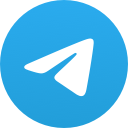
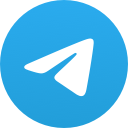
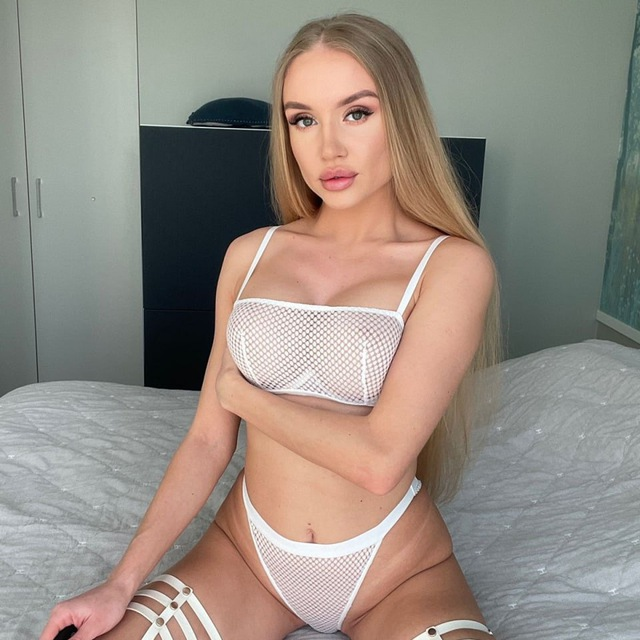
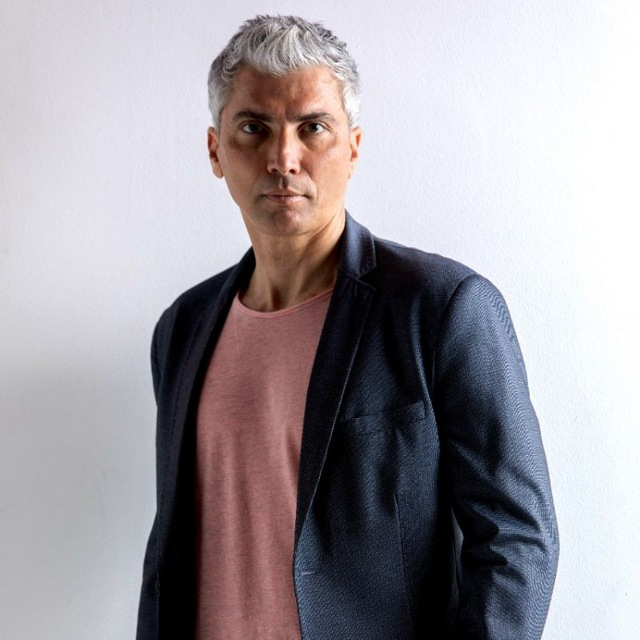
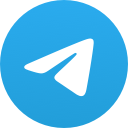
...
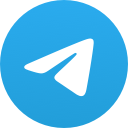
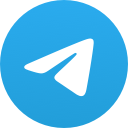
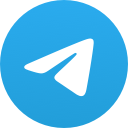
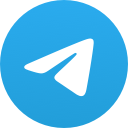
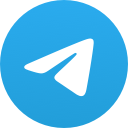

In [35]:
# Crea un mapa base. Ajusta la ubicación inicial y el nivel de zoom según sea necesario.
mapa = folium.Map(location=[39.477988, -0.332996], zoom_start=12)

# Itera sobre cada usuario en tu JSON
for user_id, user_info in data.items():
    # Extrae la latitud y longitud promedio
    lat = user_info['coordinates_average']['latitude']
    lon = user_info['coordinates_average']['longitude']
    
    username = user_info['username']

    if username:
        path_image = f'avatars/{username}.jpg'
    else:
        path_image = 'avatars/no_avatar.jpg'

    # Comprueba si el archivo existe
    if not os.path.isfile(path_image):
        # Si no existe, usa el archivo por defecto
        path_image = 'avatars/no_avatar.jpg'

    icon = CustomIcon(
        path_image,  # Ruta a la imagen de perfil del usuario
        icon_size=(25, 25)  # Puedes ajustar el tamaño según necesites
    )
    
    phone_text = "Sin teléfono" if user_info["phone"] is None else user_info["phone"]

    # Opcionalmente, crea una etiqueta con información del usuario
    tooltip = Tooltip(f'{user_info["first_name"]}, {phone_text}')

    # Añade un marcador al mapa para este usuario
    Marker(
        [lat, lon],
        icon=icon, 
        tooltip=tooltip
    ).add_to(mapa)

# Para visualizar el mapa directamente en Jupyter Notebook
mapa

# ChatGPT Recommendations

In [53]:
latitude = 39.4779
longitude = -0.333

text = f'En base a las coordenadas: Latitud: {latitude} - Longitud: {longitude}, ¿Podrías decirme los lugares turísticos, representativos y/o de interes, más cercanos de esas coordenadas?'

response = gpt_client.chat.completions.create(
  model="gpt-3.5-turbo",
  messages=[
    {"role": "user", "content": text}
  ]
)

print(response.choices[0].message.content)

Las coordenadas dadas corresponden a la ciudad de Valencia, en España. Algunos de los lugares turísticos, representativos y de interés más cercanos a esas coordenadas son:

1. Ciudad de las Artes y las Ciencias: Un complejo arquitectónico y cultural que alberga varios edificios emblemáticos como el Hemisférico, el Museo de las Ciencias Príncipe Felipe, el Oceanogràfic y el Palau de les Arts Reina Sofía.

2. Casco Histórico de Valencia: Esta zona incluye la Catedral de Valencia, la Plaza de la Virgen, el Mercado Central, la Lonja de la Seda y otros monumentos y edificios históricos.

3. Playa de la Malvarrosa: Una de las playas más famosas de Valencia, ideal para disfrutar del sol y el mar.

4. Barrio del Carmen: Un barrio con calles estrechas y pintorescas, lleno de bares, restaurantes, tiendas de diseño y una animada vida nocturna.

5. Jardines del Turia: Antiguo cauce del río Turia reconvertido en un extenso parque lineal que atraviesa la ciudad, perfecto para pasear, hacer deporte o

# ChatGPT Chats

In [54]:
users_with_phone = []

# Iterar sobre cada usuario en el diccionario
for user_id, user_info in data.items():
    # Comprobar si el usuario tiene un número de teléfono que no sea None
    if user_info["phone"] is not None:
        # Crear un diccionario con la información seleccionada del usuario
        user_dict = {
            "id": user_id,
            "first_name": user_info["first_name"],
            "last_name": user_info["last_name"],
            "username": user_info["username"],
            "phone": user_info["phone"]
        }
        # Añadir el diccionario a la lista
        users_with_phone.append(user_dict)

# Ahora users_with_phone_info contiene la lista de usuarios con un número de teléfono y su información seleccionada
print(users_with_phone)

[{'id': '6461415776', 'first_name': 'Thalia', 'last_name': None, 'username': 'Valencia_Thalia_Caliente', 'phone': '34621068486'}, {'id': '5533427043', 'first_name': 'R', 'last_name': '1', 'username': None, 'phone': '34624899309'}, {'id': '6197686112', 'first_name': 'Rob', 'last_name': None, 'username': 'Rober14750', 'phone': '34639023277'}]


In [55]:
# Lista para testear envío de mensajes y no enviar a otros usuarios reales
test_list = [
    {
        'id': '689330016', 'first_name': 'Santiago', 'last_name': 'Zuniga', 'username': 'Sazn26', 'phone': '573014466241'
    }
]

In [56]:
# Generating message from ChatGPT
first_name = test_list[0]['first_name']
last_name = test_list[0]['last_name']

text = f'Inicia una conversación distendida, tranquila y corta con {first_name} {last_name} que sea natural y humana'

response = gpt_client.chat.completions.create(
  model="gpt-3.5-turbo",
  messages=[
    {"role": "user", "content": text}
  ]
)

message = response.choices[0].message.content
print(message)

Hola Santiago, ¿cómo estás hoy? ¿Qué has estado haciendo últimamente que te haya hecho feliz o emocionado?


In [58]:
# Send messages to users
import nest_asyncio
nest_asyncio.apply()

# Crea una instancia del cliente de Telethon
client = TelegramClient(APP_NAME, API_ID, API_HASH)

async def get_my_user_id():
    async with client:
        await client.start()
        response = await client.send_message(test_list[0]['username'], message)
        print(response)

# Ejecutar la función para obtener el ID de usuario
client.loop.run_until_complete(get_my_user_id())

Message(id=22560, peer_id=PeerUser(user_id=689330016), date=datetime.datetime(2024, 5, 4, 17, 34, 42, tzinfo=datetime.timezone.utc), message='Hola Santiago, ¿cómo estás hoy? ¿Qué has estado haciendo últimamente que te haya hecho feliz o emocionado?', out=True, mentioned=False, media_unread=False, silent=False, post=False, from_scheduled=False, legacy=False, edit_hide=False, pinned=False, noforwards=False, invert_media=False, from_id=None, saved_peer_id=PeerUser(user_id=689330016), fwd_from=None, via_bot_id=None, reply_to=None, media=None, reply_markup=None, entities=[], views=None, forwards=None, replies=None, edit_date=None, post_author=None, grouped_id=None, reactions=None, restriction_reason=[], ttl_period=None)


In [45]:
# Get my Telegram Id
import nest_asyncio
nest_asyncio.apply()

# Crea una instancia del cliente de Telethon
client = TelegramClient(APP_NAME, API_ID, API_HASH)

async def get_my_user_id():
    async with client:
        await client.start()
        me = await client.get_me()
        print(me)

# Ejecutar la función para obtener el ID de usuario
client.loop.run_until_complete(get_my_user_id())

User(id=689330016, is_self=True, contact=True, mutual_contact=True, deleted=False, bot=False, bot_chat_history=False, bot_nochats=False, verified=False, restricted=False, min=False, bot_inline_geo=False, support=False, scam=False, apply_min_photo=True, fake=False, bot_attach_menu=False, premium=False, attach_menu_enabled=False, bot_can_edit=False, close_friend=False, stories_hidden=False, stories_unavailable=True, contact_require_premium=False, access_hash=2985551241360457188, first_name='S', last_name='Z', username='Sazn26', phone='573014466241', photo=None, status=UserStatusOffline(was_online=datetime.datetime(2024, 5, 4, 15, 23, 58, tzinfo=datetime.timezone.utc)), bot_info_version=None, restriction_reason=[], bot_inline_placeholder=None, lang_code=None, emoji_status=None, usernames=[], stories_max_id=None, color=None, profile_color=None)
